In [1]:
import pathlib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.datasets import make_classification
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split

from imblearn.under_sampling import RandomUnderSampler

In [2]:
def make_data(sep):
    """
    `make_data` creates artificial data using sklearn `make_classification` function.
    It returns a pandas DataFrame that consists of 2 features and the a 2-class target 
    column.

    sep [float]: The factor multiplying the hypercube size. Larger values spread out the 
    clusters/classes and make the classification task easier.
    """
    X, y = make_classification(
        n_samples=1000,
        n_features=2,
        n_redundant=0,
        n_clusters_per_class=1,
        weights=[0.99],
        class_sep=sep,
        random_state=42
    )

    X = pd.DataFrame(X, columns=["varA", "varB"])
    y = pd.Series(y)
    return X, y


 0    985
1     15
dtype: int64


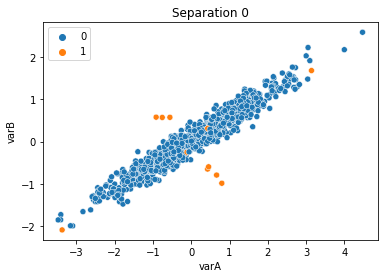


 0    985
1     15
dtype: int64


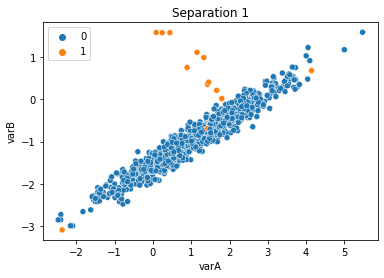


 0    985
1     15
dtype: int64


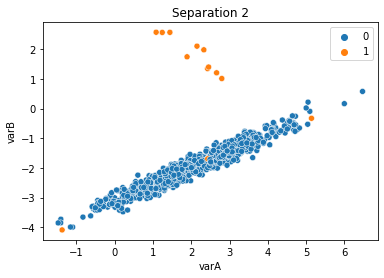

In [3]:
# Visualization of data used in this notebook
for sep in np.arange(0, 3):
    X, y = make_data(sep)
    print(f"\n {y.value_counts()}")
    sns.scatterplot(data=X, x="varA", y="varB", hue=y)
    plt.title(f"Separation {sep}")
    plt.show()

In [4]:
X, y = make_data(sep=2)

# Balancing ratio of 1
rus = RandomUnderSampler(sampling_strategy="auto", random_state=42, replacement=True)
X_resampled, y_resampled = rus.fit_resample(X, y)

In [5]:
print(f"Size of original data: {X.shape, y.shape}\n")
print(f"Distribution of the target in the original data:\n{y.value_counts()}\n")
print("-------------------------------------------------------------------------\n")
print(f"Size of resampled data: {X_resampled.shape, y_resampled.shape}\n")
print(f"Distribution of the target in the resampled data:\n{y_resampled.value_counts()}\n")

Size of original data: ((1000, 2), (1000,))

Distribution of the target in the original data:
0    985
1     15
dtype: int64

-------------------------------------------------------------------------

Size of resampled data: ((30, 2), (30,))

Distribution of the target in the resampled data:
0    15
1    15
dtype: int64



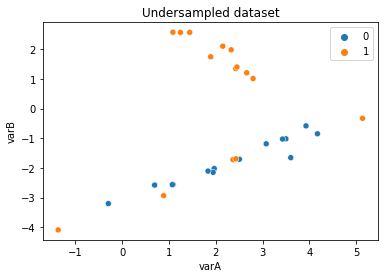

In [6]:
sns.scatterplot(data=X_resampled, x="varA", y="varB", hue=y_resampled)
plt.title(f"Undersampled dataset")
plt.show()

# KDD 2004
## Random undersampling

In [8]:
# Dataset path
dataset_folder = pathlib.Path("../../../Datasets")
dataset_file = "kdd2004.csv"
dataset_path = dataset_folder/dataset_file

if not dataset_path.exists():
    raise FileExistsError(f"This path doesn't correspond to any file: {dataset_path.resolve()}")

In [17]:
df = pd.read_csv(dataset_path)

df["target"] = df["target"].map({-1:0, 1:1})

print(f"The shape of the dataset: {df.shape}\n")
print(f"The distribution of the target column:\n {df.target.value_counts(normalize=True)}")

The shape of the dataset: (145751, 75)

The distribution of the target column:
 0    0.991108
1    0.008892
Name: target, dtype: float64


In [18]:
X_train, X_test, y_train, y_test = train_test_split(df.drop(labels=["target"], axis=1), 
                                                    df["target"],
                                                    train_size=0.7)
X_train.shape, X_test.shape

((102025, 74), (43726, 74))

In [19]:
rus = RandomUnderSampler(sampling_strategy="auto", replacement=True)
X_train_resampled, y_train_resampled = rus.fit_resample(X_train, y_train)

In [20]:
print(f"Original target distribution:\n {y_train.value_counts()}\n")
print(f"Resampled target distribution:\n {y_train_resampled.value_counts()}")

Original target distribution:
 0    101115
1       910
Name: target, dtype: int64

Resampled target distribution:
 0    910
1    910
Name: target, dtype: int64


<AxesSubplot:xlabel='0', ylabel='1'>

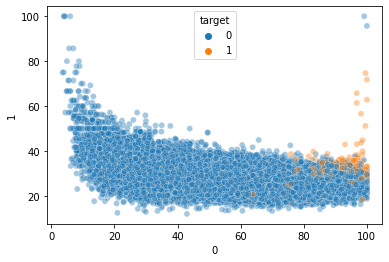

In [26]:
# We plot the points in the features 0 and 1 space
sns.scatterplot(data=X_train, x="0", y="1", hue=y_train, alpha=0.4)

In [24]:
col_names = [str(i) for i in range(74)] + ["target"]

data_resampled = pd.concat([X_train_resampled, y_train_resampled], axis=1)
data_resampled.columns = col_names

<AxesSubplot:xlabel='0', ylabel='1'>

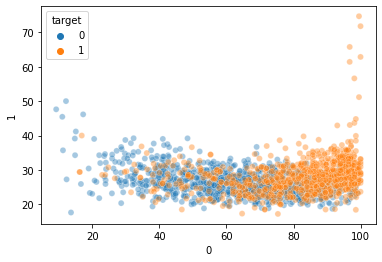

In [27]:
# Random undersampling preserves the original distribution
sns.scatterplot(data=data_resampled, x="0", y="1", hue="target", alpha=0.4)

## Model comparison

In [28]:
def build_run_rf(X_train, X_test, y_train, y_test):
    rf = RandomForestClassifier(n_estimators=200, random_state=42, max_depth=4)
    rf.fit(X_train, y_train)

    print("Train set\n")
    train_pred = rf.predict_proba(X_train)
    print(f"Random forest ROC-AUC: {roc_auc_score(y_train, train_pred[:, 1])}\n")

    print("Test set\n")
    test_pred = rf.predict_proba(X_test)
    print(f"Random forest ROC-AUC: {roc_auc_score(y_test, test_pred[:, 1])}")

In [29]:
# Original dataset
build_run_rf(X_train, X_test, y_train, y_test)

Train set

Random forest ROC-AUC: 0.9739693298838827

Test set

Random forest ROC-AUC: 0.97005993697263


In [31]:
# Resampled dataset
# A slight increase in performance compared to unbalanced dataset
# with the advantage that the dataset is smaller
# (but this is not really conclusive though)
build_run_rf(X_train_resampled, X_test, y_train_resampled, y_test)

Train set

Random forest ROC-AUC: 0.9941915227629513

Test set

Random forest ROC-AUC: 0.9855500309637497
